In [1]:
import pandas as pd
from datetime import datetime
from datetime import time
import matplotlib.pyplot as plt

In [11]:
# reading all call records
calls_22 = pd.read_csv("data/policecalls2022.csv")
calls_23 = pd.read_csv("data/policecalls2023.csv")
calls_24 = pd.read_csv("data/policecalls2024.csv")

In [77]:
# concatenate each data frame
calls = pd.concat([calls_22, calls_23, calls_24], ignore_index=True)
weather = pd.concat([weather_22, weather_23, weather_24], ignore_index=True)

In [78]:
# let us first make column names lowercase
calls.columns = calls.columns.str.lower()

In [79]:
# EID is a identification so let us make it an object
calls['eid'] = calls['eid'].astype(str)

In [80]:
calls = calls.drop(columns=['city', 'state'])

In [81]:
calls["Timestamp"] = pd.to_datetime(calls["cdts"].str[:14], format='%Y%m%d%H%M%S', errors='coerce')

In [82]:
pp_calls = calls.drop(columns=['eid',
                                     'call_number',
                                     'report_date', 
                                     'offense_date', 
                                     'start_date', 
                                     'cdts'])

In [83]:
calls

,cdts,eid,start_date,call_number,priority,report_date,offense_date,offense_time,calltype_code,call_type,final_dispo_code,final_dispo,address,Timestamp
0,20220101042916PS,8913184,1/1/2022 12:00:00 AM,P220010180,2,1/1/2022 12:00:00 AM,1/1/2022 12:00:00 AM,02:49:02,1066,SUSPICIOUS PERSON,N,No report required; dispatch record only,[800]-[900] JEANNE AV,2022-01-01 04:29:16
1,20220101043036PS,8913196,1/1/2022 12:00:00 AM,P220010191,2,1/1/2022 12:00:00 AM,1/1/2022 12:00:00 AM,03:05:51,415,DISTURBANCE,N,No report required; dispatch record only,[1500]-[1600] SOUTHWEST EX,2022-01-01 04:30:36
2,20220101043827PS,8913252,1/1/2022 12:00:00 AM,P220010236,2,1/1/2022 12:00:00 AM,1/1/2022 12:00:00 AM,04:35:25,911UNK,UNK TYPE 911 CALL,CAN,Canceled,[4800]-[4900] WESTMONT AV,2022-01-01 04:38:27
3,20220101044026PS,8913216,1/1/2022 12:00:00 AM,P220010206,2,1/1/2022 12:00:00 AM,1/1/2022 12:00:00 AM,03:38:14,SUSCIR,SUSPICIOUS CIRCUMSTANCES,N,No report required; dispatch record only,[3600]-[3700] GREENLEE DR,2022-01-01 04:40:26
4,20220102052501PS,8914182,1/1/2022 12:00:00 AM,P220010965,4,1/1/2022 12:00:00 AM,1/1/2022 12:00:00 AM,23:25:49,11300,NARCOTICS,A,Arrest Made,E CAPITOL EX & EVERGREEN PL,2022-01-02 05:25:01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3998458,20240228143421PS,9917241,3/2/2024 12:00:00 AM,P240590531,6,2/28/2024 12:00:00 AM,2/28/2024 12:00:00 AM,14:08:34,1195,VEHICLE STOP,N,No report required; dispatch record only,[5700]-[5800] ALMADEN RD,2024-02-28 14:34:21
3998459,20240228143423PS,9917234,3/2/2024 12:00:00 AM,P240590526,5,2/28/2024 12:00:00 AM,2/28/2024 12:00:00 AM,14:06:06,22500,PARKING VIOLATION,N,No report required; dispatch record only,[100]-[200] MCCREERY AV,2024-02-28 14:34:23
3998460,20240228143755PS,9917176,3/2/2024 12:00:00 AM,P240590481,2,2/28/2024 12:00:00 AM,2/28/2024 12:00:00 AM,13:14:37,242,BATTERY,R,Report taken,[0]-[100] N MARKET ST,2024-02-28 14:37:55
3998461,20240228144042PS,9917220,3/2/2024 12:00:00 AM,P240590514,6,2/28/2024 12:00:00 AM,2/28/2024 12:00:00 AM,13:53:41,1195,VEHICLE STOP,N,No report required; dispatch record only,STORY RD & HOPKINS DR,2024-02-28 14:40:42


In [84]:
pp_calls

,priority,offense_time,calltype_code,call_type,final_dispo_code,final_dispo,address,Timestamp
0,2,02:49:02,1066,SUSPICIOUS PERSON,N,No report required; dispatch record only,[800]-[900] JEANNE AV,2022-01-01 04:29:16
1,2,03:05:51,415,DISTURBANCE,N,No report required; dispatch record only,[1500]-[1600] SOUTHWEST EX,2022-01-01 04:30:36
2,2,04:35:25,911UNK,UNK TYPE 911 CALL,CAN,Canceled,[4800]-[4900] WESTMONT AV,2022-01-01 04:38:27
3,2,03:38:14,SUSCIR,SUSPICIOUS CIRCUMSTANCES,N,No report required; dispatch record only,[3600]-[3700] GREENLEE DR,2022-01-01 04:40:26
4,4,23:25:49,11300,NARCOTICS,A,Arrest Made,E CAPITOL EX & EVERGREEN PL,2022-01-02 05:25:01
...,...,...,...,...,...,...,...,...
3998458,6,14:08:34,1195,VEHICLE STOP,N,No report required; dispatch record only,[5700]-[5800] ALMADEN RD,2024-02-28 14:34:21
3998459,5,14:06:06,22500,PARKING VIOLATION,N,No report required; dispatch record only,[100]-[200] MCCREERY AV,2024-02-28 14:34:23
3998460,2,13:14:37,242,BATTERY,R,Report taken,[0]-[100] N MARKET ST,2024-02-28 14:37:55
3998461,6,13:53:41,1195,VEHICLE STOP,N,No report required; dispatch record only,STORY RD & HOPKINS DR,2024-02-28 14:40:42


In [85]:
dispo_mapping = {}

for index, row in pp_calls.iterrows():
    dispo_code = row['final_dispo_code']
    dispo = row['final_dispo']
    dispo_mapping[dispo_code] = dispo

print(dispo_mapping)

{'N': 'No report required; dispatch record only', 'CAN': 'Canceled', 'A': 'Arrest Made', 'GD': 'No Disposition', 'T': 'Turned over To (TOT)', 'NR': 'No Response', 'G': 'Gone on Arrival/unable to locate', 'R': 'Report taken', 'DUPNCAN': 'No Disposition', 'D': 'Traffic Citation Issued, Hazardous Violation', 'U': 'Unfounded event', 'H': 'Courtesy Service/Citizen or agency assist', 'E': 'Traffic Citation Issued, Non-Hazardous Violation', 'O': 'Supplemental report taken', 'B': 'Arrest by Warrant', 'ADV': 'No Disposition', 'F': 'Field Interview (F.I.) Completed', 'C': 'Criminal Citation', 'P': 'Prior case, follow-up activity only', 'M': 'Stranded motorist assist', 'Z': 'No Disposition', 'TOT': 'No Disposition'}


In [86]:
pp_calls = pp_calls.drop(columns=['final_dispo'])

In [87]:
calltype_mapping = {}

for index, row in pp_calls.iterrows():
    calltype_code = row['calltype_code']
    calltype = row['call_type']
    calltype_mapping[calltype_code] = calltype

print(len(calltype_mapping))
print(calltype_mapping)

212
{'1066': 'SUSPICIOUS PERSON', '415': 'DISTURBANCE', '911UNK': 'UNK TYPE 911 CALL', 'SUSCIR': 'SUSPICIOUS CIRCUMSTANCES', '11300': 'NARCOTICS', '415FC': 'DISTURBANCE, FIRECRACKERS', '1057': 'FIREARMS DISCHARGED', '1095': 'PEDESTRIAN STOP', 'WELCKEMS': 'WELFARE CHECK (COMBINED EVENT)', 'AID': 'PUBLIC SAFETY ASSISTANCE', '1033A': 'ALARM, AUDIBLE', '415M': 'DISTURBANCE, MUSIC', '1070': 'PROWLER', 'WELCK': 'WELFARE CHECK', '1033S': 'ALARM, SILENT', '23103': 'RECKLESS DRIVING', '1066W': 'SUSPICIOUS PERSON W/ WEAPON', '5150': 'MENTALLY DISTURBED PERSON', '242': 'BATTERY', '417': 'BRANDISHING A WEAPON', '22500': 'PARKING VIOLATION', '1195': 'VEHICLE STOP', '1154': 'SUSPICIOUS VEHICLE', '415F': 'DISTURBANCE, FAMILY', '20002': 'MISDEMEANOR HIT AND RUN', '484': 'THEFT', '415A': 'DISTURBANCE, FIGHT', '10851': 'STOLEN VEHICLE', '1182': 'VEHICLE ACCIDENT, PROPERTY DAMAGE', '10851R': 'RECOVERED STOLEN VEHICLE', '12025': 'CARRYING A CONCEALED WEAPON', 'FNDPRP': 'FOUND PROPERTY', '602PC': 'TRESPASS

In [88]:
pp_calls = pp_calls.drop(columns=['call_type'])

In [89]:
pp_calls['offense_time'][0]

'02:49:02'

In [90]:
pp_calls['offense_time'][0] + pp_calls['offense_time'][1]

'02:49:0203:05:51'

In [96]:
timestamp1 = pd.Timestamp('04:29:16')
timestamp2 = pd.Timestamp('07:45:30')

In [100]:
from datetime import datetime, timedelta

# 주어진 문자열 형태의 데이터
time_strings = ['04:29:16', '02:15:30', '03:45:10']

# 모든 시간을 datetime.datetime 형식으로 변환하고 합산
total_time = datetime.strptime('00:00:00', '%H:%M:%S')
for time_str in time_strings:
    time_obj = datetime.strptime(time_str, '%H:%M:%S')
    total_time += timedelta(hours=time_obj.hour, minutes=time_obj.minute, seconds=time_obj.second)

# 결과 출력
print("전체 시간 합계:", total_time.time())


전체 시간 합계: 10:29:56


In [93]:
pd.to_datetime(pp_calls['offense_time'][0], format='%H:%M:%S', errors='coerce') + pd.to_datetime(pp_calls['offense_time'][1], format='%H:%M:%S', errors='coerce')

TypeError: unsupported operand type(s) for +: 'Timestamp' and 'Timestamp'

In [101]:
pp_calls['year'] = pp_calls['Timestamp'].dt.year
pp_calls['date'] = pp_calls['Timestamp'].dt.date

In [107]:
def sum_offense_time(group):
    total_time = datetime.strptime('00:00:00', '%H:%M:%S')
    for time_str in group:
        time_obj = datetime.strptime(time_str, '%H:%M:%S')
        total_time += timedelta(hours=time_obj.hour, minutes=time_obj.minute, seconds=time_obj.second)
        print(total_time)
    return total_time.time()

pp_calls.groupby(['year', 'date'])['offense_time'].apply(sum_offense_time)

1900-01-01 02:49:02
1900-01-01 05:54:53
1900-01-01 10:30:18
1900-01-01 14:08:32
1900-01-01 14:09:31
1900-01-01 14:12:36
1900-01-01 14:16:17
1900-01-01 14:24:12
1900-01-01 14:27:15
1900-01-01 14:37:39
1900-01-01 15:01:44
1900-01-01 15:24:44
1900-01-01 15:50:34
1900-01-01 16:08:27
1900-01-01 16:23:44
1900-01-01 16:35:10
1900-01-01 16:53:33
1900-01-01 17:00:04
1900-01-01 17:26:28
1900-01-01 17:37:21
1900-01-01 18:19:16
1900-01-01 18:43:12
1900-01-01 19:48:15
1900-01-01 21:11:54
1900-01-01 21:27:58
1900-01-01 22:22:30
1900-01-01 23:40:24
1900-01-01 23:57:38
1900-01-02 00:12:55
1900-01-02 00:47:01
1900-01-02 01:18:17
1900-01-02 01:27:37
1900-01-02 01:56:20
1900-01-02 02:26:46
1900-01-02 02:32:20
1900-01-02 02:41:42
1900-01-02 03:33:11
1900-01-02 06:28:22
1900-01-02 07:16:26
1900-01-02 07:25:01
1900-01-02 08:24:21
1900-01-02 09:22:45
1900-01-02 10:20:10
1900-01-02 10:32:15
1900-01-02 10:42:04
1900-01-02 11:07:41
1900-01-02 11:50:57
1900-01-02 12:42:12
1900-01-02 13:27:40
1900-01-02 14:03:51


1902-01-04 09:30:25
1902-01-04 21:17:01
1902-01-05 12:42:08
1902-01-06 05:56:05
1902-01-06 22:38:30
1902-01-07 12:36:04
1902-01-08 03:26:49
1902-01-08 12:30:53
1902-01-09 03:23:47
1902-01-09 18:48:54
1902-01-10 10:20:22
1902-01-11 00:26:01
1902-01-11 13:53:50
1902-01-12 05:16:58
1902-01-12 22:16:01
1902-01-13 14:14:00
1902-01-14 05:19:43
1902-01-14 17:29:04
1902-01-15 09:18:22
1902-01-16 01:43:54
1902-01-16 23:50:07
1902-01-17 21:16:31
1902-01-18 13:23:26
1902-01-19 09:10:12
1902-01-20 04:53:22
1902-01-20 23:26:01
1902-01-21 18:46:26
1902-01-22 14:37:08
1902-01-23 10:19:35
1902-01-24 06:16:09
1902-01-25 04:29:01
1902-01-26 01:58:40
1902-01-27 00:27:38
1902-01-27 22:16:04
1902-01-28 20:11:37
1902-01-29 18:39:10
1902-01-30 15:56:02
1902-01-31 13:34:22
1902-01-31 18:08:57
1902-02-01 03:16:38
1902-02-01 11:58:26
1902-02-01 20:41:06
1902-02-02 05:31:32
1902-02-02 14:47:07
1902-02-02 23:39:21
1902-02-03 08:54:59
1902-02-03 17:15:18
1902-02-03 22:04:57
1902-02-04 18:34:02
1902-02-04 23:08:39


1905-12-19 05:11:15
1905-12-20 03:52:05
1905-12-21 01:14:04
1905-12-22 00:31:58
1905-12-22 23:06:38
1905-12-23 22:28:16
1905-12-24 20:27:04
1905-12-25 19:38:28
1905-12-26 18:45:48
1905-12-26 20:13:36
1905-12-26 21:44:36
1905-12-26 23:49:41
1905-12-27 01:23:38
1905-12-27 05:04:17
1905-12-27 08:49:25
1905-12-27 10:24:59
1905-12-27 11:52:47
1905-12-28 10:56:17
1905-12-28 13:12:00
1905-12-28 15:00:52
1905-12-28 18:01:28
1905-12-28 20:49:18
1905-12-28 22:15:48
1905-12-28 22:28:31
1905-12-29 02:14:15
1905-12-29 03:28:25
1905-12-29 07:14:09
1905-12-29 11:11:31
1905-12-29 14:31:49
1905-12-30 14:31:02
1905-12-30 17:36:49
1905-12-30 21:45:37
1905-12-31 14:24:02
1905-12-31 17:18:09
1905-12-31 20:10:59
1906-01-01 00:26:17
1906-01-01 04:38:30
1906-01-01 09:10:40
1906-01-01 14:26:30
1906-01-01 19:10:54
1906-01-01 23:13:35
1906-01-02 03:59:54
1906-01-02 11:37:32
1906-01-02 18:41:52
1906-01-03 01:51:50
1906-01-03 09:29:28
1906-01-03 17:01:25
1906-01-04 00:46:01
1906-01-04 07:21:43
1906-01-04 13:30:47


1901-10-28 05:36:01
1901-10-28 23:13:53
1901-10-29 16:58:33
1901-10-30 09:15:35
1901-10-31 02:20:19
1901-10-31 17:39:30
1901-11-01 10:56:25
1901-11-02 04:45:04
1901-11-02 22:05:38
1901-11-03 15:22:12
1901-11-04 08:03:14
1901-11-05 04:54:16
1901-11-06 00:43:01
1901-11-06 15:26:14
1901-11-07 11:39:56
1901-11-08 07:42:58
1901-11-09 04:21:56
1901-11-10 01:46:30
1901-11-10 22:55:27
1901-11-11 21:34:27
1901-11-12 19:24:56
1901-11-13 19:00:16
1901-11-14 17:38:07
1901-11-15 12:02:18
1901-11-16 06:17:06
1901-11-17 01:40:05
1901-11-17 20:59:04
1901-11-18 16:27:50
1901-11-19 11:50:53
1901-11-20 07:01:25
1901-11-21 02:37:51
1901-11-22 02:24:09
1901-11-23 01:44:21
1901-11-23 22:50:29
1901-11-24 21:44:39
1901-11-25 19:42:11
1901-11-26 18:28:23
1901-11-26 20:14:11
1901-11-26 21:58:41
1901-11-26 23:13:32
1901-11-26 23:55:03
1901-11-27 01:54:57
1901-11-27 03:50:54
1901-11-27 05:33:21
1901-11-27 06:45:25
1901-11-27 08:34:37
1901-11-27 11:32:45
1901-11-27 14:36:13
1901-11-27 17:19:58
1901-11-27 19:56:12


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1900-03-13 07:07:12
1900-03-13 08:37:31
1900-03-13 09:54:25
1900-03-13 11:36:43
1900-03-13 13:20:31
1900-03-13 14:27:01
1900-03-13 14:48:06
1900-03-13 16:08:24
1900-03-14 01:20:31
1900-03-14 07:56:01
1900-03-14 15:31:45
1900-03-14 22:54:13
1900-03-15 08:08:05
1900-03-15 17:20:16
1900-03-16 02:07:04
1900-03-16 11:23:40
1900-03-16 20:21:27
1900-03-17 05:33:51
1900-03-17 14:20:47
1900-03-18 00:06:51
1900-03-18 10:09:32
1900-03-18 19:36:04
1900-03-19 04:29:57
1900-03-19 13:01:21
1900-03-19 22:32:30
1900-03-20 10:07:19
1900-03-20 20:55:00
1900-03-21 08:01:54
1900-03-21 19:00:25
1900-03-22 06:45:04
1900-03-22 18:18:48
1900-03-23 02:17:56
1900-03-23 13:52:45
1900-03-23 22:01:39
1900-03-24 03:41:25
1900-03-24 14:54:50
1900-03-25 02:15:51
1900-03-25 13:55:09
1900-03-26 00:46:33
1900-03-26 17:20:16
1900-03-27 08:34:20
1900-03-27 20:59:39
1900-03-28 09:23:50
1900-03-29 01:25:13
1900-03-29 18:02:53
1900-03-30 08:48:20
1900-03-31 00:52:12
1900-03-31 17:23:47
1900-04-01 05:35:19
1900-04-01 20:59:26


1907-10-02 11:42:12
1907-10-02 20:07:38
1907-10-03 03:42:24
1907-10-03 11:13:51
1907-10-03 17:26:40
1907-10-04 01:07:21
1907-10-04 08:51:20
1907-10-04 20:23:12
1907-10-05 04:23:41
1907-10-05 12:54:25
1907-10-05 17:57:35
1907-10-06 05:34:25
1907-10-06 17:14:22
1907-10-07 04:31:03
1907-10-07 16:09:07
1907-10-08 03:44:28
1907-10-08 16:32:53
1907-10-09 05:25:56
1907-10-09 15:46:34
1907-10-10 03:42:53
1907-10-10 15:32:37
1907-10-11 03:05:57
1907-10-11 15:44:42
1907-10-12 03:23:52
1907-10-12 16:24:20
1907-10-13 13:03:55
1907-10-14 10:40:27
1907-10-15 08:31:36
1907-10-16 04:42:15
1907-10-17 01:58:27
1907-10-17 10:40:50
1907-10-17 21:43:52
1907-10-18 07:58:46
1907-10-18 18:23:17
1907-10-19 02:45:52
1907-10-19 12:59:55
1907-10-19 23:56:29
1907-10-20 04:05:50
1907-10-20 15:04:06
1907-10-21 00:54:35
1907-10-21 09:17:56
1907-10-21 19:28:09
1907-10-22 04:10:08
1907-10-22 15:13:59
1907-10-23 01:02:51
1907-10-23 11:14:02
1907-10-23 21:15:47
1907-10-24 09:09:21
1907-10-24 20:31:17
1907-10-25 08:46:41


1900-11-02 06:41:28
1900-11-03 02:41:32
1900-11-03 17:38:09
1900-11-04 10:09:24
1900-11-05 05:30:07
1900-11-06 01:23:01
1900-11-06 21:44:42
1900-11-07 16:00:03
1900-11-08 11:16:52
1900-11-09 05:05:32
1900-11-10 00:38:10
1900-11-10 20:27:00
1900-11-11 17:25:06
1900-11-12 14:30:39
1900-11-13 12:20:19
1900-11-14 09:22:59
1900-11-15 06:41:44
1900-11-16 04:16:52
1900-11-17 01:14:18
1900-11-17 22:12:41
1900-11-18 19:58:30
1900-11-19 17:45:14
1900-11-20 12:42:18
1900-11-21 10:20:25
1900-11-22 07:09:10
1900-11-23 04:31:57
1900-11-24 02:17:32
1900-11-25 00:05:40
1900-11-25 05:08:27
1900-11-25 09:53:08
1900-11-25 13:42:16
1900-11-25 17:06:28
1900-11-25 22:13:20
1900-11-26 02:50:04
1900-11-26 07:20:39
1900-11-26 10:32:42
1900-11-26 15:33:29
1900-11-26 20:34:49
1900-11-26 23:40:05
1900-11-27 02:03:09
1900-11-27 07:33:40
1900-11-27 11:57:31
1900-11-27 17:24:19
1900-11-27 21:18:12
1900-11-28 01:08:47
1900-11-28 04:44:30
1900-11-28 08:49:17
1900-11-28 12:50:06
1900-11-28 16:21:46
1900-11-29 12:55:09


1905-06-22 03:25:21
1905-06-22 11:40:55
1905-06-22 18:52:19
1905-06-23 18:41:40
1905-06-24 16:59:20
1905-06-25 16:53:41
1905-06-25 16:59:36
1905-06-26 13:07:04
1905-06-27 11:25:09
1905-06-27 11:37:35
1905-06-28 11:34:08
1905-06-28 11:36:52
1905-06-29 11:25:39
1905-06-30 10:39:45
1905-07-01 08:47:11
1905-07-02 08:31:52
1905-07-02 08:53:55
1905-07-02 09:00:20
1905-07-02 09:09:49
1905-07-02 09:46:26
1905-07-03 07:54:57
1905-07-04 04:49:37
1905-07-04 05:19:56
1905-07-05 02:45:13
1905-07-06 02:43:21
1905-07-06 03:32:57
1905-07-06 04:22:33
1905-07-06 14:10:15
1905-07-07 08:46:11
1905-07-07 18:41:51
1905-07-08 04:41:04
1905-07-08 14:17:10
1905-07-08 23:52:51
1905-07-09 08:48:25
1905-07-10 01:34:44
1905-07-10 18:32:21
1905-07-11 07:50:45
1905-07-11 21:23:06
1905-07-12 12:06:48
1905-07-13 00:46:12
1905-07-13 15:28:54
1905-07-14 06:17:40
1905-07-14 21:05:50
1905-07-15 11:26:23
1905-07-16 01:59:09
1905-07-16 16:39:35
1905-07-17 10:11:35
1905-07-18 02:18:05
1905-07-18 19:24:20
1905-07-19 13:35:13


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1907-09-04 15:01:40
1907-09-04 16:33:29
1907-09-04 17:42:04
1907-09-04 19:21:57
1907-09-04 19:50:08
1907-09-04 21:30:01
1907-09-04 22:54:44
1907-09-05 06:26:28
1907-09-05 13:16:45
1907-09-05 20:35:06
1907-09-06 03:00:55
1907-09-06 08:20:19
1907-09-06 16:13:31
1907-09-06 17:23:56
1907-09-06 23:37:51
1907-09-07 07:00:57
1907-09-07 13:51:03
1907-09-08 11:30:12
1907-09-09 00:37:12
1907-09-09 07:05:33
1907-09-09 15:12:22
1907-09-09 23:01:29
1907-09-10 06:44:08
1907-09-11 04:13:17
1907-09-11 23:22:28
1907-09-12 21:06:56
1907-09-13 18:51:24
1907-09-14 16:22:58
1907-09-15 14:07:14
1907-09-16 11:54:21
1907-09-17 09:21:26
1907-09-18 07:08:17
1907-09-19 01:01:42
1907-09-19 21:19:39
1907-09-20 17:58:12
1907-09-21 14:12:50
1907-09-22 03:51:27
1907-09-22 16:50:43
1907-09-23 05:31:35
1907-09-23 17:56:13
1907-09-24 05:55:33
1907-09-24 16:49:57
1907-09-25 03:06:06
1907-09-25 13:58:29
1907-09-26 02:22:16
1907-09-26 14:57:10
1907-09-27 01:43:28
1907-09-27 13:49:49
1907-09-28 01:57:29
1907-09-28 13:17:24


1909-03-27 00:56:51
1909-03-27 04:15:44
1909-03-27 07:41:46
1909-03-27 11:10:13
1909-03-27 16:07:32
1909-03-27 18:18:31
1909-03-27 23:18:33
1909-03-28 02:06:45
1909-03-28 07:14:59
1909-03-28 11:48:24
1909-03-28 16:25:35
1909-03-28 19:42:47
1909-03-28 22:37:50
1909-03-29 00:32:49
1909-03-29 03:24:20
1909-03-29 05:39:46
1909-03-29 08:36:17
1909-03-29 11:37:18
1909-03-29 13:12:03
1909-03-29 15:28:07
1909-03-29 18:26:39
1909-03-29 21:25:48
1909-03-30 00:32:31
1909-03-30 03:40:19
1909-03-30 04:03:20
1909-03-30 05:08:38
1909-03-30 06:01:31
1909-03-30 07:21:20
1909-03-30 09:32:44
1909-03-30 11:22:23
1909-03-30 13:20:36
1909-03-30 14:08:08
1909-03-30 15:39:27
1909-03-30 16:42:06
1909-03-30 18:02:25
1909-03-30 20:04:45
1909-03-30 21:54:31
1909-03-31 00:16:56
1909-03-31 02:20:12
1909-03-31 04:17:19
1909-03-31 05:48:13
1909-03-31 08:02:07
1909-04-01 02:16:24
1909-04-01 18:52:39
1909-04-02 12:49:47
1909-04-03 05:45:03
1909-04-03 22:45:45
1909-04-04 15:35:56
1909-04-05 09:33:04
1909-04-06 02:33:31


1907-06-15 13:23:42
1907-06-15 13:46:49
1907-06-15 20:03:37
1907-06-16 18:52:40
1907-06-16 19:34:15
1907-06-16 20:50:46
1907-06-16 22:23:26
1907-06-16 23:06:04
1907-06-17 00:29:06
1907-06-17 04:55:09
1907-06-17 13:08:48
1907-06-17 21:27:22
1907-06-18 05:31:54
1907-06-18 14:22:00
1907-06-18 20:38:43
1907-06-19 02:38:08
1907-06-19 04:05:51
1907-06-19 10:37:16
1907-06-19 17:24:08
1907-06-20 01:00:53
1907-06-20 10:28:31
1907-06-20 19:55:35
1907-06-21 04:02:47
1907-06-21 13:35:28
1907-06-21 23:05:35
1907-06-22 01:45:21
1907-06-22 11:32:32
1907-06-22 21:26:21
1907-06-23 06:28:17
1907-06-23 16:12:03
1907-06-24 01:19:17
1907-06-24 11:03:42
1907-06-24 19:12:51
1907-06-25 04:31:16
1907-06-25 09:17:03
1907-06-25 19:11:00
1907-06-26 04:27:39
1907-06-26 14:19:00
1907-06-26 23:40:11
1907-06-27 09:43:50
1907-06-27 18:55:40
1907-06-28 04:59:49
1907-06-28 15:01:45
1907-06-29 10:21:19
1907-06-30 05:30:00
1907-06-30 14:56:48
1907-07-01 01:11:09
1907-07-01 20:26:31
1907-07-02 15:45:39
1907-07-03 11:12:18


1906-04-12 02:08:38
1906-04-12 02:28:44
1906-04-12 23:46:12
1906-04-13 17:02:20
1906-04-14 09:42:31
1906-04-15 02:50:19
1906-04-15 08:43:28
1906-04-15 14:35:35
1906-04-16 10:32:53
1906-04-16 16:39:46
1906-04-17 12:20:38
1906-04-18 05:53:27
1906-04-18 23:28:39
1906-04-19 16:55:07
1906-04-20 08:38:43
1906-04-21 02:02:20
1906-04-21 19:49:15
1906-04-22 13:09:54
1906-04-23 06:53:50
1906-04-23 23:42:43
1906-04-24 17:01:10
1906-04-25 08:25:18
1906-04-25 23:28:59
1906-04-26 18:32:51
1906-04-27 13:40:14
1906-04-28 09:37:13
1906-04-29 05:43:29
1906-04-29 23:58:28
1906-04-30 17:58:01
1906-05-01 14:14:04
1906-05-02 08:15:21
1906-05-03 03:31:55
1906-05-03 23:10:27
1906-05-04 17:56:29
1906-05-05 12:33:34
1906-05-06 08:52:50
1906-05-07 05:17:14
1906-05-08 01:08:06
1906-05-08 21:22:59
1906-05-09 17:56:03
1906-05-10 13:17:24
1906-05-11 08:37:57
1906-05-12 04:39:23
1906-05-13 00:17:43
1906-05-13 19:49:04
1906-05-14 15:27:21
1906-05-15 11:24:23
1906-05-16 07:16:08
1906-05-16 22:26:27
1906-05-17 17:00:00


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1900-10-10 18:32:29
1900-10-11 15:23:44
1900-10-12 03:45:58
1900-10-12 11:58:11
1900-10-13 00:17:54
1900-10-13 11:59:00
1900-10-14 00:03:42
1900-10-14 20:44:02
1900-10-15 08:41:00
1900-10-16 06:14:29
1900-10-17 03:45:35
1900-10-17 21:57:20
1900-10-18 19:18:57
1900-10-19 10:27:48
1900-10-19 23:32:36
1900-10-19 23:43:53
1900-10-20 22:41:20
1900-10-21 06:38:58
1900-10-21 15:54:49
1900-10-22 00:23:35
1900-10-22 09:54:22
1900-10-22 19:28:08
1900-10-23 04:54:18
1900-10-23 14:01:20
1900-10-24 11:53:03
1900-10-25 02:01:01
1900-10-25 17:58:15
1900-10-26 07:19:55
1900-10-26 23:17:50
1900-10-27 15:15:57
1900-10-28 04:02:57
1900-10-28 19:20:01
1900-10-29 10:22:44
1900-10-30 02:00:18
1900-10-30 14:46:45
1900-10-31 04:50:01
1900-10-31 20:47:57
1900-11-01 12:40:05
1900-11-02 09:59:12
1900-11-03 04:05:19
1900-11-04 00:53:04
1900-11-04 20:20:12
1900-11-05 16:54:10
1900-11-06 14:45:57
1900-11-06 17:46:49
1900-11-07 14:46:15
1900-11-07 17:30:25
1900-11-07 19:57:10
1900-11-07 20:53:32
1900-11-07 23:55:36


1906-07-18 07:44:10
1906-07-19 06:08:09
1906-07-19 07:56:43
1906-07-19 08:35:47
1906-07-19 11:11:36
1906-07-19 13:33:09
1906-07-19 15:29:42
1906-07-19 17:29:51
1906-07-19 18:54:29
1906-07-20 14:59:12
1906-07-20 20:04:35
1906-07-20 22:36:35
1906-07-21 15:06:41
1906-07-22 12:11:07
1906-07-23 10:01:52
1906-07-24 00:15:24
1906-07-24 02:39:40
1906-07-24 04:45:47
1906-07-24 08:02:18
1906-07-24 15:41:23
1906-07-25 00:25:00
1906-07-25 08:52:22
1906-07-25 16:22:25
1906-07-26 00:17:08
1906-07-26 08:41:15
1906-07-26 19:59:02
1906-07-27 03:06:48
1906-07-27 11:14:46
1906-07-27 18:14:47
1906-07-28 02:18:18
1906-07-28 10:39:46
1906-07-28 21:38:43
1906-07-29 08:56:44
1906-07-29 20:27:15
1906-07-30 07:46:05
1906-07-30 19:14:56
1906-07-31 04:43:25
1906-07-31 16:02:43
1906-08-01 03:29:52
1906-08-01 14:46:00
1906-08-02 02:09:10
1906-08-02 13:46:26
1906-08-03 01:04:35
1906-08-03 10:57:55
1906-08-03 20:22:01
1906-08-04 07:21:54
1906-08-04 19:00:26
1906-08-05 06:00:29
1906-08-05 18:52:53
1906-08-06 07:56:35


1906-09-02 04:57:26
1906-09-02 06:22:03
1906-09-02 07:41:17
1906-09-02 09:04:28
1906-09-03 08:54:30
1906-09-04 07:57:08
1906-09-04 09:06:51
1906-09-04 09:31:27
1906-09-04 10:59:54
1906-09-04 12:34:42
1906-09-04 13:53:33
1906-09-05 13:40:38
1906-09-05 14:52:09
1906-09-06 02:28:49
1906-09-06 14:49:32
1906-09-07 03:38:18
1906-09-07 18:57:42
1906-09-08 08:56:02
1906-09-08 21:31:49
1906-09-09 12:46:52
1906-09-10 05:28:09
1906-09-10 20:05:51
1906-09-11 12:11:30
1906-09-12 04:12:13
1906-09-12 19:47:43
1906-09-13 12:08:08
1906-09-14 05:15:32
1906-09-14 22:02:17
1906-09-15 15:18:49
1906-09-16 08:30:57
1906-09-17 01:26:03
1906-09-17 18:20:24
1906-09-18 14:06:17
1906-09-19 09:15:03
1906-09-20 05:16:08
1906-09-21 01:13:15
1906-09-21 17:03:41
1906-09-22 13:01:03
1906-09-23 07:59:25
1906-09-24 04:20:43
1906-09-25 00:35:00
1906-09-25 20:08:32
1906-09-26 16:50:08
1906-09-27 13:02:05
1906-09-28 09:18:13
1906-09-29 04:12:37
1906-09-29 20:54:41
1906-09-30 15:13:55
1906-10-01 00:17:52
1906-10-01 08:27:01


1906-09-02 04:43:12
1906-09-02 18:37:15
1906-09-03 07:15:59
1906-09-03 20:00:14
1906-09-04 09:18:29
1906-09-04 22:06:20
1906-09-05 11:34:04
1906-09-05 22:46:41
1906-09-06 12:15:09
1906-09-07 02:01:32
1906-09-07 15:15:44
1906-09-08 03:05:54
1906-09-08 15:16:52
1906-09-09 08:57:53
1906-09-10 03:03:06
1906-09-10 20:58:42
1906-09-11 09:59:38
1906-09-11 23:35:48
1906-09-12 13:05:23
1906-09-13 02:23:24
1906-09-13 16:22:00
1906-09-14 10:30:24
1906-09-15 04:15:08
1906-09-15 21:58:45
1906-09-16 14:14:07
1906-09-17 08:18:12
1906-09-18 01:41:15
1906-09-18 19:45:18
1906-09-19 10:24:05
1906-09-20 04:14:33
1906-09-20 22:06:18
1906-09-21 15:49:55
1906-09-22 14:57:49
1906-09-23 14:06:29
1906-09-24 13:15:49
1906-09-25 12:26:00
1906-09-26 11:02:45
1906-09-27 08:47:23
1906-09-28 05:44:36
1906-09-29 03:43:58
1906-09-30 01:47:05
1906-09-30 22:22:30
1906-10-01 19:36:37
1906-10-02 17:16:31
1906-10-03 15:14:56
1906-10-04 12:49:13
1906-10-05 11:47:05
1906-10-06 10:56:41
1906-10-07 10:13:42
1906-10-08 09:18:22


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1902-01-08 07:03:02
1902-01-08 20:11:45
1902-01-09 07:36:35
1902-01-09 20:29:34
1902-01-10 09:19:26
1902-01-10 22:36:56
1902-01-11 11:33:20
1902-01-11 23:08:30
1902-01-12 20:41:37
1902-01-13 19:13:14
1902-01-14 16:19:29
1902-01-15 14:44:15
1902-01-16 08:50:54
1902-01-17 04:22:29
1902-01-17 23:40:04
1902-01-18 21:20:37
1902-01-19 18:57:04
1902-01-20 17:13:45
1902-01-21 09:21:58
1902-01-22 07:53:34
1902-01-23 06:29:05
1902-01-24 04:47:54
1902-01-25 01:57:13
1902-01-25 23:41:17
1902-01-26 21:39:56
1902-01-27 20:21:02
1902-01-28 15:20:43
1902-01-29 13:25:36
1902-01-30 11:58:16
1902-01-31 09:23:43
1902-01-31 18:01:59
1902-02-01 02:35:07
1902-02-01 12:13:54
1902-02-01 19:38:03
1902-02-02 04:57:03
1902-02-02 14:38:36
1902-02-02 23:30:13
1902-02-03 07:52:16
1902-02-03 19:30:15
1902-02-04 10:02:49
1902-02-04 23:41:57
1902-02-05 14:12:57
1902-02-06 03:58:03
1902-02-06 14:45:24
1902-02-07 05:22:38
1902-02-07 18:47:16
1902-02-08 17:35:57
1902-02-09 07:13:57
1902-02-09 20:40:49
1902-02-10 09:20:37


1900-02-23 19:05:10
1900-02-24 07:12:01
1900-02-25 00:02:58
1900-02-25 15:54:56
1900-02-26 06:49:33
1900-02-26 23:32:37
1900-02-27 15:39:19
1900-02-28 03:29:36
1900-02-28 19:19:08
1900-03-01 12:16:36
1900-03-02 05:03:18
1900-03-02 16:47:32
1900-03-03 07:47:35
1900-03-03 14:26:38
1900-03-04 06:09:01
1900-03-04 23:05:21
1900-03-05 16:23:58
1900-03-05 22:09:04
1900-03-06 05:22:54
1900-03-06 14:07:30
1900-03-07 00:35:20
1900-03-07 10:35:19
1900-03-07 20:09:08
1900-03-08 04:36:05
1900-03-08 15:03:10
1900-03-09 01:08:51
1900-03-09 11:06:47
1900-03-09 21:06:12
1900-03-10 07:42:26
1900-03-10 18:28:42
1900-03-11 12:04:15
1900-03-12 08:47:00
1900-03-13 05:24:27
1900-03-14 01:55:02
1900-03-14 21:56:58
1900-03-15 18:38:43
1900-03-16 14:25:29
1900-03-17 10:44:50
1900-03-18 06:29:54
1900-03-19 01:14:00
1900-03-19 19:32:28
1900-03-20 16:14:13
1900-03-21 01:02:04
1900-03-21 10:29:39
1900-03-21 20:12:34
1900-03-22 11:47:24
1900-03-23 04:15:44
1900-03-23 12:55:03
1900-03-23 22:27:22
1900-03-24 07:49:28


1902-05-04 12:41:00
1902-05-05 01:15:54
1902-05-05 15:12:38
1902-05-06 05:22:31
1902-05-06 18:33:13
1902-05-07 06:48:23
1902-05-07 20:31:22
1902-05-08 10:48:38
1902-05-09 01:06:51
1902-05-09 12:57:24
1902-05-10 02:07:42
1902-05-10 16:21:19
1902-05-11 06:36:32
1902-05-11 20:02:40
1902-05-12 04:41:18
1902-05-13 01:04:26
1902-05-13 23:19:59
1902-05-14 20:49:50
1902-05-15 17:54:27
1902-05-16 11:05:20
1902-05-17 08:30:55
1902-05-18 05:47:19
1902-05-19 03:45:28
1902-05-20 01:06:40
1902-05-20 23:28:30
1902-05-21 21:37:46
1902-05-22 20:07:56
1902-05-23 18:45:45
1902-05-24 16:44:32
1902-05-25 04:19:17
1902-05-25 16:22:31
1902-05-26 04:25:45
1902-05-26 16:49:19
1902-05-27 05:15:15
1902-05-27 17:23:09
1902-05-28 05:14:59
1902-05-28 17:34:41
1902-05-29 02:38:52
1902-05-29 13:28:45
1902-05-29 23:49:21
1902-05-30 20:47:43
1902-05-31 07:09:16
1902-05-31 15:26:14
1902-06-01 01:55:34
1902-06-01 13:18:01
1902-06-01 19:55:30
1902-06-02 07:17:31
1902-06-02 15:42:44
1902-06-03 00:15:45
1902-06-03 20:06:10


1905-11-10 22:09:26
1905-11-11 03:40:00
1905-11-11 08:56:52
1905-11-11 15:51:43
1905-11-11 22:03:10
1905-11-12 04:58:49
1905-11-12 12:08:49
1905-11-12 19:18:41
1905-11-13 02:05:42
1905-11-13 04:07:59
1905-11-13 11:51:40
1905-11-13 19:20:50
1905-11-14 02:25:56
1905-11-15 02:10:03
1905-11-16 00:23:46
1905-11-16 09:32:37
1905-11-16 20:15:57
1905-11-17 07:12:44
1905-11-17 18:09:23
1905-11-18 05:46:24
1905-11-18 14:17:48
1905-11-19 05:56:36
1905-11-19 21:34:17
1905-11-20 12:11:31
1905-11-21 03:36:59
1905-11-21 19:09:02
1905-11-22 11:26:14
1905-11-23 02:31:24
1905-11-23 17:27:16
1905-11-24 09:51:10
1905-11-25 09:05:11
1905-11-26 07:20:36
1905-11-26 07:46:33
1905-11-26 17:16:14
1905-11-27 02:33:57
1905-11-27 12:21:12
1905-11-27 21:26:47
1905-11-28 06:53:03
1905-11-28 13:19:18
1905-11-28 22:25:03
1905-11-29 08:25:55
1905-11-29 14:03:00
1905-11-29 23:56:52
1905-11-30 10:49:26
1905-11-30 20:56:52
1905-12-01 00:28:40
1905-12-01 03:05:17
1905-12-01 06:55:03
1905-12-01 09:12:01
1905-12-01 12:30:45


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1904-05-29 15:36:35
1904-05-30 14:24:07
1904-05-31 11:12:45
1904-06-01 08:32:07
1904-06-02 07:22:26
1904-06-03 04:59:03
1904-06-04 04:19:19
1904-06-04 05:22:15
1904-06-04 22:24:14
1904-06-05 01:16:01
1904-06-05 03:39:03
1904-06-05 05:46:42
1904-06-05 07:20:56
1904-06-05 09:13:31
1904-06-05 11:23:59
1904-06-05 12:44:45
1904-06-06 10:55:52
1904-06-06 13:08:48
1904-06-07 07:46:46
1904-06-07 08:44:41
1904-06-07 11:15:57
1904-06-08 09:59:23
1904-06-08 11:55:11
1904-06-09 03:06:35
1904-06-09 06:19:06
1904-06-09 09:22:16
1904-06-09 12:36:25
1904-06-09 15:07:35
1904-06-09 18:00:40
1904-06-09 19:39:39
1904-06-09 22:41:21
1904-06-10 01:33:19
1904-06-10 04:45:05
1904-06-10 07:03:06
1904-06-10 10:41:41
1904-06-10 15:00:53
1904-06-10 16:48:00
1904-06-10 20:41:19
1904-06-11 07:22:38
1904-06-11 15:55:25
1904-06-12 00:46:34
1904-06-12 09:38:31
1904-06-12 19:14:47
1904-06-13 05:30:23
1904-06-13 16:00:58
1904-06-14 01:12:29
1904-06-14 08:05:25
1904-06-14 17:45:08
1904-06-15 02:49:09
1904-06-16 00:08:05


1907-10-13 20:29:29
1907-10-14 04:43:10
1907-10-14 13:00:27
1907-10-14 21:16:13
1907-10-14 23:55:16
1907-10-15 07:54:39
1907-10-15 14:37:43
1907-10-15 22:53:29
1907-10-16 07:25:43
1907-10-16 14:29:42
1907-10-16 22:23:05
1907-10-17 06:15:02
1907-10-17 14:26:12
1907-10-17 22:59:08
1907-10-18 04:07:17
1907-10-18 10:24:30
1907-10-18 18:01:43
1907-10-19 02:36:09
1907-10-19 10:43:01
1907-10-19 15:00:55
1907-10-19 22:44:14
1907-10-20 06:06:45
1907-10-20 15:02:44
1907-10-21 00:07:51
1907-10-21 08:48:34
1907-10-21 16:37:45
1907-10-22 00:03:03
1907-10-22 07:49:58
1907-10-22 16:39:50
1907-10-23 01:11:55
1907-10-23 09:36:21
1907-10-23 18:26:38
1907-10-23 22:30:31
1907-10-24 07:14:53
1907-10-24 15:33:34
1907-10-25 05:32:33
1907-10-25 16:02:21
1907-10-26 05:58:50
1907-10-26 18:16:01
1907-10-27 05:04:04
1907-10-27 18:09:36
1907-10-28 06:28:04
1907-10-28 20:43:22
1907-10-29 08:49:48
1907-10-29 23:02:33
1907-10-30 12:38:33
1907-10-30 21:10:43
1907-10-31 06:24:19
1907-10-31 12:44:48
1907-10-31 21:56:19


1903-10-06 08:25:44
1903-10-06 20:14:55
1903-10-07 09:16:57
1903-10-08 08:21:23
1903-10-09 07:32:44
1903-10-10 06:00:20
1903-10-11 05:23:36
1903-10-12 05:06:06
1903-10-13 04:43:11
1903-10-13 15:42:34
1903-10-14 01:48:56
1903-10-14 11:29:05
1903-10-14 23:05:26
1903-10-15 10:53:00
1903-10-15 22:10:09
1903-10-16 10:16:20
1903-10-16 17:57:18
1903-10-17 06:09:41
1903-10-17 15:12:33
1903-10-18 02:54:47
1903-10-18 15:02:59
1903-10-19 03:22:37
1903-10-19 15:31:28
1903-10-20 03:22:10
1903-10-20 12:20:47
1903-10-20 23:47:34
1903-10-21 12:57:19
1903-10-22 02:35:33
1903-10-22 16:02:41
1903-10-23 05:51:38
1903-10-23 17:59:53
1903-10-24 07:04:46
1903-10-24 20:24:08
1903-10-25 15:53:42
1903-10-26 12:32:52
1903-10-27 08:13:18
1903-10-28 04:32:34
1903-10-28 21:55:19
1903-10-29 17:04:04
1903-10-30 11:52:53
1903-10-31 08:58:04
1903-11-01 06:22:07
1903-11-01 18:20:35
1903-11-02 08:18:03
1903-11-02 10:18:24
1903-11-02 16:18:52
1903-11-02 22:29:31
1903-11-03 04:35:47
1903-11-03 23:30:42
1903-11-04 19:42:01


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




1908-01-22 14:32:32
1908-01-23 01:34:37
1908-01-23 12:36:42
1908-01-23 22:48:19
1908-01-24 12:09:20
1908-01-25 01:19:41
1908-01-25 10:30:38
1908-01-25 21:42:15
1908-01-26 06:30:59
1908-01-26 19:43:33
1908-01-27 09:20:07
1908-01-27 23:07:33
1908-01-28 11:38:42
1908-01-28 23:54:30
1908-01-29 13:29:47
1908-01-30 03:26:52
1908-01-30 16:19:30
1908-01-31 03:39:40
1908-01-31 17:52:07
1908-02-01 07:45:56
1908-02-01 21:55:59
1908-02-02 12:29:07
1908-02-03 03:07:18
1908-02-03 18:29:59
1908-02-04 06:56:33
1908-02-04 17:56:17
1908-02-05 05:02:02
1908-02-05 16:43:28
1908-02-06 05:17:35
1908-02-06 17:07:45
1908-02-06 20:16:11
1908-02-07 01:27:20
1908-02-07 07:08:58
1908-02-07 12:53:47
1908-02-07 18:35:24
1908-02-07 23:45:50
1908-02-08 20:31:12
1908-02-09 11:14:08
1908-02-10 09:00:29
1908-02-11 06:30:26
1908-02-12 04:28:58
1908-02-13 02:23:12
1908-02-14 00:02:49
1908-02-14 22:00:05
1908-02-15 19:56:41
1908-02-16 17:13:40
1908-02-17 15:00:48
1908-02-18 12:52:23
1908-02-19 09:22:52
1908-02-20 06:57:16

1904-08-21 15:42:26
1904-08-22 07:21:39
1904-08-22 22:34:22
1904-08-23 12:02:47
1904-08-24 03:11:34
1904-08-24 19:04:21
1904-08-25 16:19:08
1904-08-26 13:20:37
1904-08-27 10:36:40
1904-08-28 07:34:52
1904-08-29 05:03:06
1904-08-29 22:43:08
1904-08-30 18:02:34
1904-08-31 14:22:50
1904-09-01 11:48:47
1904-09-02 09:15:37
1904-09-03 05:38:58
1904-09-04 03:07:43
1904-09-04 19:48:11
1904-09-05 17:22:57
1904-09-06 14:04:29
1904-09-07 11:40:22
1904-09-08 09:18:06
1904-09-09 05:53:55
1904-09-10 02:37:02
1904-09-11 00:05:54
1904-09-11 17:41:57
1904-09-12 13:58:28
1904-09-13 09:26:39
1904-09-14 07:12:33
1904-09-15 02:50:34
1904-09-16 00:30:02
1904-09-16 22:21:20
1904-09-17 02:30:05
1904-09-17 07:47:57
1904-09-17 13:28:22
1904-09-17 19:14:41
1904-09-18 01:50:00
1904-09-18 06:12:39
1904-09-18 10:07:06
1904-09-18 16:02:25
1904-09-18 21:54:12
1904-09-19 02:49:04
1904-09-19 04:55:57
1904-09-19 08:41:05
1904-09-20 07:48:32
1904-09-21 05:10:22
1904-09-21 06:50:02
1904-09-21 08:08:39
1904-09-22 06:44:15


1900-05-22 13:54:51
1900-05-22 19:17:48
1900-05-23 17:52:02
1900-05-23 22:45:53
1900-05-24 09:32:03
1900-05-24 18:37:20
1900-05-25 04:33:25
1900-05-25 14:37:51
1900-05-25 23:41:09
1900-05-26 11:37:46
1900-05-26 22:45:08
1900-05-27 10:41:59
1900-05-27 21:42:54
1900-05-28 09:26:38
1900-05-28 21:06:44
1900-05-29 08:42:49
1900-05-29 09:47:23
1900-05-29 13:26:52
1900-05-29 16:55:28
1900-05-29 18:32:20
1900-05-29 20:50:12
1900-05-29 21:35:14
1900-05-30 19:49:19
1900-05-31 18:10:02
1900-06-01 17:15:54
1900-06-01 17:49:50
1900-06-01 18:35:51
1900-06-01 19:28:40
1900-06-01 22:00:52
1900-06-01 23:44:47
1900-06-02 02:18:40
1900-06-02 03:44:44
1900-06-02 05:43:41
1900-06-02 06:50:01
1900-06-02 10:22:25
1900-06-02 12:33:45
1900-06-03 08:59:42
1900-06-03 12:39:45
1900-06-03 13:03:21
1900-06-03 15:08:05
1900-06-03 17:54:31
1900-06-03 23:24:54
1900-06-04 05:17:10
1900-06-05 01:05:22
1900-06-05 05:50:09
1900-06-05 12:17:53
1900-06-05 17:40:50
1900-06-06 04:19:32
1900-06-06 16:43:29
1900-06-07 04:41:55


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1903-10-08 14:25:57
1903-10-09 01:40:49
1903-10-09 14:28:22
1903-10-10 02:03:06
1903-10-10 20:11:29
1903-10-11 17:35:31
1903-10-12 09:31:56
1903-10-13 00:50:19
1903-10-13 16:21:28
1903-10-14 07:17:22
1903-10-14 21:11:57
1903-10-15 14:22:35
1903-10-16 11:20:20
1903-10-17 07:39:01
1903-10-18 04:35:08
1903-10-18 23:34:16
1903-10-19 08:33:06
1903-10-19 18:22:49
1903-10-20 03:27:52
1903-10-20 13:00:18
1903-10-20 22:37:59
1903-10-21 07:02:54
1903-10-21 21:43:02
1903-10-22 11:04:02
1903-10-23 00:38:40
1903-10-23 14:35:57
1903-10-24 14:22:23
1903-10-24 20:16:58
1903-10-25 02:38:54
1903-10-25 08:44:54
1903-10-25 15:09:29
1903-10-26 03:36:38
1903-10-26 17:22:08
1903-10-27 06:45:44
1903-10-27 20:48:53
1903-10-28 09:04:21
1903-10-28 15:13:04
1903-10-28 21:12:47
1903-10-29 02:37:21
1903-10-29 09:28:45
1903-10-29 15:47:52
1903-10-29 23:05:28
1903-10-30 04:54:00
1903-10-30 11:21:58
1903-10-30 15:16:00
1903-10-30 21:36:55
1903-10-31 05:15:49
1903-10-31 12:27:50
1903-10-31 19:40:56
1903-11-01 00:36:37


1906-09-15 05:22:18
1906-09-15 16:07:46
1906-09-16 02:14:12
1906-09-16 13:29:36
1906-09-16 23:26:11
1906-09-17 10:16:32
1906-09-17 20:15:43
1906-09-18 07:30:56
1906-09-18 18:03:02
1906-09-19 05:29:46
1906-09-19 16:39:13
1906-09-19 17:29:54
1906-09-19 18:56:38
1906-09-19 22:49:15
1906-09-20 00:21:08
1906-09-20 02:09:20
1906-09-20 03:50:38
1906-09-20 05:22:42
1906-09-20 06:22:26
1906-09-20 07:30:13
1906-09-20 09:19:20
1906-09-20 10:24:10
1906-09-20 10:44:18
1906-09-20 12:31:51
1906-09-20 14:14:20
1906-09-20 15:52:12
1906-09-20 16:01:03
1906-09-20 20:45:13
1906-09-21 01:25:34
1906-09-21 04:06:34
1906-09-21 07:02:49
1906-09-22 03:07:05
1906-09-22 06:11:28
1906-09-22 08:37:56
1906-09-22 11:24:10
1906-09-22 13:07:22
1906-09-22 16:37:23
1906-09-22 21:48:10
1906-09-23 01:38:54
1906-09-23 05:05:49
1906-09-23 13:45:22
1906-09-23 22:15:21
1906-09-24 08:32:37
1906-09-24 16:35:25
1906-09-25 01:57:44
1906-09-25 12:19:07
1906-09-25 20:42:18
1906-09-26 07:03:20
1906-09-26 14:39:31
1906-09-27 00:24:12


1904-08-26 22:07:35
1904-08-27 10:29:32
1904-08-27 23:03:47
1904-08-28 15:45:27
1904-08-29 08:44:13
1904-08-30 02:14:17
1904-08-30 17:58:35
1904-08-31 11:08:37
1904-09-01 03:46:46
1904-09-01 20:00:50
1904-09-02 12:17:17
1904-09-03 05:47:53
1904-09-03 23:42:45
1904-09-04 16:44:31
1904-09-05 08:54:00
1904-09-06 02:42:31
1904-09-06 19:31:02
1904-09-07 12:27:15
1904-09-08 05:53:59
1904-09-08 22:12:08
1904-09-09 15:56:14
1904-09-10 09:34:17
1904-09-11 03:41:51
1904-09-11 18:31:26
1904-09-12 07:59:35
1904-09-12 22:27:26
1904-09-13 11:19:10
1904-09-13 22:43:47
1904-09-14 13:18:54
1904-09-15 00:53:41
1904-09-15 15:50:06
1904-09-16 07:08:14
1904-09-16 20:45:06
1904-09-17 11:30:33
1904-09-18 01:29:25
1904-09-18 14:22:10
1904-09-19 03:34:32
1904-09-19 17:40:58
1904-09-20 09:07:29
1904-09-21 00:14:13
1904-09-21 14:04:56
1904-09-22 05:30:02
1904-09-22 20:29:18
1904-09-22 21:15:25
1904-09-22 21:51:38
1904-09-23 21:22:30
1904-09-23 21:52:45
1904-09-23 22:54:57
1904-09-23 23:03:18
1904-09-23 23:45:52


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



year  date      
2022  2022-01-01    04:39:33
      2022-01-02    19:38:30
      2022-01-03    10:12:43
      2022-01-04    11:00:41
      2022-01-05    02:56:19
                      ...   
2024  2024-02-28    11:22:55
      2024-02-29    21:51:30
      2024-03-01    16:20:27
      2024-03-02    15:25:45
      2024-03-03    05:15:56
Name: offense_time, Length: 764, dtype: object

In [109]:
pp_calls

,priority,offense_time,calltype_code,final_dispo_code,address,Timestamp,year,date
0,2,02:49:02,1066,N,[800]-[900] JEANNE AV,2022-01-01 04:29:16,2022,2022-01-01
1,2,03:05:51,415,N,[1500]-[1600] SOUTHWEST EX,2022-01-01 04:30:36,2022,2022-01-01
2,2,04:35:25,911UNK,CAN,[4800]-[4900] WESTMONT AV,2022-01-01 04:38:27,2022,2022-01-01
3,2,03:38:14,SUSCIR,N,[3600]-[3700] GREENLEE DR,2022-01-01 04:40:26,2022,2022-01-01
4,4,23:25:49,11300,A,E CAPITOL EX & EVERGREEN PL,2022-01-02 05:25:01,2022,2022-01-02
...,...,...,...,...,...,...,...,...
3998458,6,14:08:34,1195,N,[5700]-[5800] ALMADEN RD,2024-02-28 14:34:21,2024,2024-02-28
3998459,5,14:06:06,22500,N,[100]-[200] MCCREERY AV,2024-02-28 14:34:23,2024,2024-02-28
3998460,2,13:14:37,242,R,[0]-[100] N MARKET ST,2024-02-28 14:37:55,2024,2024-02-28
3998461,6,13:53:41,1195,N,STORY RD & HOPKINS DR,2024-02-28 14:40:42,2024,2024-02-28


In [112]:
pp_calls[pp_calls['Timestamp'].dt.date == pd.to_datetime('2022-01-01').date()]

,priority,offense_time,calltype_code,final_dispo_code,address,Timestamp,year,date
0,2,02:49:02,1066,N,[800]-[900] JEANNE AV,2022-01-01 04:29:16,2022,2022-01-01
1,2,03:05:51,415,N,[1500]-[1600] SOUTHWEST EX,2022-01-01 04:30:36,2022,2022-01-01
2,2,04:35:25,911UNK,CAN,[4800]-[4900] WESTMONT AV,2022-01-01 04:38:27,2022,2022-01-01
3,2,03:38:14,SUSCIR,N,[3600]-[3700] GREENLEE DR,2022-01-01 04:40:26,2022,2022-01-01
5,4,00:00:59,415FC,CAN,BRANHAM LN & SNELL AV,2022-01-01 00:03:07,2022,2022-01-01
...,...,...,...,...,...,...,...,...
21838,4,19:03:41,415M,CAN,[400]-[500] N 13TH ST,2022-01-01 20:06:39,2022,2022-01-01
21839,6,19:40:56,1195X,N,SNELL AV & BRANHAM LN,2022-01-01 20:09:39,2022,2022-01-01
21840,2,19:26:43,415,N,[2400]-[2500] S KING RD,2022-01-01 20:11:02,2022,2022-01-01
21841,2,15:18:34,1091A,N,[3400]-[3500] STORY LN,2022-01-01 20:11:10,2022,2022-01-01


In [41]:
pp_calls.dtypes

priority                     int64
offense_time                object
calltype_code               object
final_dispo_code            object
address                     object
Timestamp           datetime64[ns]
dtype: object

In [53]:
pp_calls['offense_time'] = pp_calls['offense_time'].astype(str)

In [55]:
pp_calls['offense_time'] = pd.to_datetime(pp_calls['offense_time'].str[:], format='%H:%M:%S', errors='coerce')

In [58]:
pp_calls['offense_time'] = pp_calls['offense_time'].dt.strftime('%H:%M:%S')

In [71]:
pp_calls['offense_time'][0]

0    02:49:02
0    15:01:44
0    00:53:50
Name: offense_time, dtype: object

In [ ]:
year = pp_calls['Timestamp'].year
date = pp_calls[]

In [60]:
pp_calls.dtypes

priority                     int64
offense_time                object
calltype_code               object
final_dispo_code            object
address                     object
Timestamp           datetime64[ns]
dtype: object

2022-01-01 04:29:16 이런 timestamp가 있다고 할 때, 연도랑 날짜 별로 offense_time을 합쳐서 새로운 데이터프레임을 구할거야. offense_time의 값은 02:49:02 이런식으로 

In [114]:
date_column = pp_calls['Timestamp'].dt.date
daily_count = pp_calls.groupby(pd.Grouper(key='Timestamp', freq='D')).size()
print(daily_count)

Timestamp
2022-01-01    5558
2022-01-02    5082
2022-01-03    5628
2022-01-04    5566
2022-01-05    5936
              ... 
2024-02-28    2888
2024-02-29    2162
2024-03-01    1506
2024-03-02     808
2024-03-03      47
Freq: D, Length: 793, dtype: int64


In [127]:
daily_count.size

790

In [119]:
daily_count[1]

5082

In [123]:
daily_count = daily_count.drop(labels='2024-03-03')
daily_count = daily_count.drop(labels='2024-03-02')
daily_count = daily_count.drop(labels='2024-03-01')

In [124]:
daily_count

Timestamp
2022-01-01    5558
2022-01-02    5082
2022-01-03    5628
2022-01-04    5566
2022-01-05    5936
              ... 
2024-02-25    3901
2024-02-26    3945
2024-02-27    3440
2024-02-28    2888
2024-02-29    2162
Freq: D, Length: 790, dtype: int64

<Axes: xlabel='Timestamp'>

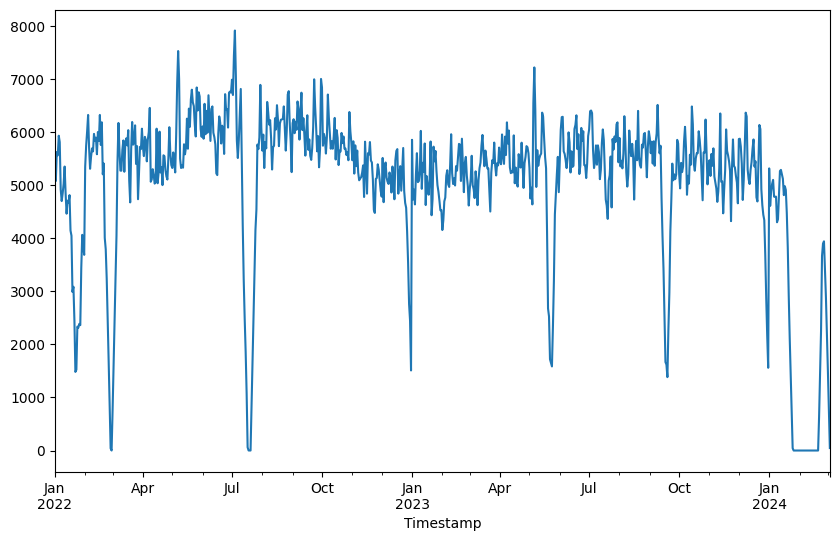

In [115]:
daily_count.plot(kind='line', figsize=(10, 6))

# Weather Data Pre Processing

In [228]:
# reading all weather records
weather_22 = pd.read_csv("data/san jose weather 2022.csv")
weather_23 = pd.read_csv("data/san jose weather 2023.csv")
weather_24 = pd.read_csv("data/san jose weather 2024.csv")

In [229]:
weather = pd.concat([weather_22, weather_23, weather_24], ignore_index=True)

In [230]:
weather = weather.drop(labels=791)
weather = weather.drop(labels=790)

In [232]:
weather['preciptype'] = weather['preciptype'].fillna('no precip')

In [233]:
def fix_datatype(df):
    
    
    # datetime column into datetime object
    df['datetime'] = pd.to_datetime(df['datetime'])
    
    
    # get time for sunrise and sunset
    def extract_time(time_string):
        # we only need time since datetime column already has date
        time_string = time_string.split('T')[1]
        return datetime.strptime(time_string, "%H:%M:%S").time()
    
    df['sunrise'] = df['sunrise'].apply(lambda x: extract_time(x))
    df['sunset'] = df['sunset'].apply(lambda x: extract_time(x))
    
    
    # changing percentage to decimal
    df['humidity'] = df['humidity'] / 100
    df['precipcover'] = df['precipcover'] / 100
    df['cloudcover'] = df['cloudcover'] / 100
    
    
    # change into boolean
    df['precipprob'] = df['precipprob'].apply(lambda x: True if x == 100 else False)

In [234]:
fix_datatype(weather)

In [235]:
useless_columns = ['name', 'dew', 'precipprob', 'solarradiation', 'solarenergy', 
                   'severerisk', 'sealevelpressure', 'icon', 'stations']

weather = weather.drop(columns=useless_columns)
weather.head()

,datetime,tempmax,tempmin,temp,feelslikemax,feelslikemin,feelslike,humidity,precip,precipcover,...,windspeed,winddir,cloudcover,visibility,uvindex,sunrise,sunset,moonphase,conditions,description
0,2022-01-01,55.0,35.1,43.3,55.0,32.5,42.2,0.668,0.000,0.0000,...,5.9,179.7,0.212,8.6,6,07:21:56,17:00:46,0.97,Partially cloudy,Partly cloudy throughout the day.
1,2022-01-02,59.9,33.1,44.0,59.9,29.9,43.1,0.685,0.000,0.0000,...,9.1,157.0,0.254,9.9,6,07:22:04,17:01:35,0.00,Partially cloudy,Partly cloudy throughout the day.
2,2022-01-03,56.0,44.0,50.6,56.0,39.5,49.1,0.765,0.000,0.0000,...,13.7,143.2,0.919,9.9,3,07:22:10,17:02:24,0.03,Overcast,Cloudy skies throughout the day.
3,2022-01-04,61.0,50.0,54.6,61.0,50.0,54.6,0.835,0.001,0.0417,...,10.2,189.1,0.833,9.9,5,07:22:14,17:03:16,0.07,"Rain, Partially cloudy",Partly cloudy throughout the day with early mo...
4,2022-01-05,62.8,51.1,55.6,62.8,51.1,55.6,0.841,0.000,0.0000,...,11.2,327.2,0.861,9.8,6,07:22:16,17:04:08,0.10,Partially cloudy,Partly cloudy throughout the day.


In [236]:
weather.index = weather['datetime']

In [237]:
drop_columns = ['datetime', 'description', 'conditions', 'preciptype']
weather = weather.drop(columns=drop_columns)

In [238]:
weather.dtypes

tempmax         float64
tempmin         float64
temp            float64
feelslikemax    float64
feelslikemin    float64
feelslike       float64
humidity        float64
precip          float64
precipcover     float64
snow              int64
snowdepth         int64
windgust        float64
windspeed       float64
winddir         float64
cloudcover      float64
visibility      float64
uvindex           int64
sunrise          object
sunset           object
moonphase       float64
dtype: object

In [239]:
weather['sunrise'] = pd.to_datetime(weather['sunrise'], format='%H:%M:%S')#.dt.time
weather['sunset'] = pd.to_datetime(weather['sunset'], format='%H:%M:%S')#.dt.time

In [240]:
weather['sunrise']

datetime
2022-01-01   1900-01-01 07:21:56
2022-01-02   1900-01-01 07:22:04
2022-01-03   1900-01-01 07:22:10
2022-01-04   1900-01-01 07:22:14
2022-01-05   1900-01-01 07:22:16
                     ...        
2024-02-25   1900-01-01 06:44:33
2024-02-26   1900-01-01 06:43:13
2024-02-27   1900-01-01 06:41:52
2024-02-28   1900-01-01 06:40:31
2024-02-29   1900-01-01 06:39:09
Name: sunrise, Length: 790, dtype: datetime64[ns]

In [259]:
weather['time_difference'] = (pd.Series(weather['sunset']) - pd.Series(weather['sunrise'])).dt.total_seconds() / 3600

In [261]:
weather['time_difference']

datetime
2022-01-01     9.647222
2022-01-02     9.658611
2022-01-03     9.670556
2022-01-04     9.683889
2022-01-05     9.697778
                ...    
2024-02-25    11.212500
2024-02-26    11.251389
2024-02-27    11.290556
2024-02-28    11.329722
2024-02-29    11.368889
Name: time_difference, Length: 790, dtype: float64

In [268]:
pp_weather = weather
pp_weather = pp_weather.drop(columns=['sunrise', 'sunset'])

In [269]:
pp_weather.dtypes

tempmax            float64
tempmin            float64
temp               float64
feelslikemax       float64
feelslikemin       float64
feelslike          float64
humidity           float64
precip             float64
precipcover        float64
snow                 int64
snowdepth            int64
windgust           float64
windspeed          float64
winddir            float64
cloudcover         float64
visibility         float64
uvindex              int64
moonphase          float64
time_difference    float64
dtype: object

In [270]:
pp_weather = pp_weather.drop(columns=['snow', 'snowdepth'])

In [271]:
pp_weather

,tempmax,tempmin,temp,feelslikemax,feelslikemin,feelslike,humidity,precip,precipcover,windgust,windspeed,winddir,cloudcover,visibility,uvindex,moonphase,time_difference
datetime,,,,,,,,,,,,,,,,,
2022-01-01,55.0,35.1,43.3,55.0,32.5,42.2,0.668,0.000,0.0000,15.2,5.9,179.7,0.212,8.6,6,0.97,9.647222
2022-01-02,59.9,33.1,44.0,59.9,29.9,43.1,0.685,0.000,0.0000,21.0,9.1,157.0,0.254,9.9,6,0.00,9.658611
2022-01-03,56.0,44.0,50.6,56.0,39.5,49.1,0.765,0.000,0.0000,19.9,13.7,143.2,0.919,9.9,3,0.03,9.670556
2022-01-04,61.0,50.0,54.6,61.0,50.0,54.6,0.835,0.001,0.0417,15.0,10.2,189.1,0.833,9.9,5,0.07,9.683889
2022-01-05,62.8,51.1,55.6,62.8,51.1,55.6,0.841,0.000,0.0000,18.6,11.2,327.2,0.861,9.8,6,0.10,9.697778
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-02-25,69.9,47.9,58.0,69.9,44.7,57.8,0.655,0.000,0.0000,10.3,13.7,324.7,0.277,9.9,8,0.54,11.212500
2024-02-26,64.8,49.9,56.7,64.8,49.9,56.7,0.705,0.000,0.0000,15.0,16.9,321.3,0.710,9.9,10,0.58,11.251389
2024-02-27,62.9,44.9,54.3,62.9,43.6,54.2,0.579,0.000,0.0000,19.7,15.8,324.4,0.231,9.9,8,0.61,11.290556


# Model

In [272]:
from sklearn.linear_model import LinearRegression
X = pp_weather
y = daily_count

In [273]:
print(X)

            tempmax  tempmin  temp  feelslikemax  feelslikemin  feelslike  \
datetime                                                                    
2022-01-01     55.0     35.1  43.3          55.0          32.5       42.2   
2022-01-02     59.9     33.1  44.0          59.9          29.9       43.1   
2022-01-03     56.0     44.0  50.6          56.0          39.5       49.1   
2022-01-04     61.0     50.0  54.6          61.0          50.0       54.6   
2022-01-05     62.8     51.1  55.6          62.8          51.1       55.6   
...             ...      ...   ...           ...           ...        ...   
2024-02-25     69.9     47.9  58.0          69.9          44.7       57.8   
2024-02-26     64.8     49.9  56.7          64.8          49.9       56.7   
2024-02-27     62.9     44.9  54.3          62.9          43.6       54.2   
2024-02-28     69.7     43.9  55.2          69.7          41.5       54.8   
2024-02-29     62.8     49.8  55.8          62.8          48.3       55.7   

In [274]:
print(y)

Timestamp
2022-01-01    5558
2022-01-02    5082
2022-01-03    5628
2022-01-04    5566
2022-01-05    5936
              ... 
2024-02-25    3901
2024-02-26    3945
2024-02-27    3440
2024-02-28    2888
2024-02-29    2162
Freq: D, Length: 790, dtype: int64


In [275]:
from sklearn.model_selection import train_test_split
X_tn, X_te, y_tn, y_te = train_test_split(X, y, random_state=1)

In [276]:
from sklearn.preprocessing import StandardScaler
std_scale = StandardScaler()
std_scale.fit(X_tn)

StandardScaler()

In [277]:
X_tn_std = std_scale.transform(X_tn)
X_te_std = std_scale.transform(X_te)

In [278]:
from sklearn.linear_model import LinearRegression
clf_lr = LinearRegression()
clf_lr.fit(X_tn_std, y_tn)

LinearRegression()

In [280]:
print(clf_lr.coef_)
print(clf_lr.intercept_)

[ 1304.86507301   885.22968779   627.55603127 -1184.70545472
 -1251.08538968  -209.45007252   -30.4438333   -307.58728941
   -42.17722706   204.3320438    -12.78481094   183.92231627
    99.54166957    10.13582933  -268.86377567   -35.30401855
   335.7032332 ]
5078.775337837839


In [281]:
from sklearn.linear_model import Ridge
clf_ridge = Ridge(alpha=1)
clf_ridge.fit(X_tn_std, y_tn)

Ridge(alpha=1)

In [282]:
print(clf_ridge.coef_)
print(clf_ridge.intercept_)

[  746.61142163   677.62576271   703.35315318  -638.83324227
 -1051.52557797  -266.82001577   -46.88454373  -302.80322352
   -37.00692571   199.33445412    -5.61023854   178.53505142
   101.57671709     6.05340771  -267.03594736   -36.20787761
   331.43758096]
5078.775337837839


In [283]:
from sklearn.linear_model import Lasso
clf_lasso = Lasso(alpha=0.01)
clf_lasso.fit(X_tn_std, y_tn)

/Users/cho/.pyenv/versions/py3_8_10/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.137e+08, tolerance: 1.273e+05
  model = cd_fast.enet_coordinate_descent(


Lasso(alpha=0.01)

In [284]:
print(clf_lasso.coef_)
print(clf_lasso.intercept_)

[ 1732.64641209  1112.04961958   179.27450585 -1566.18144432
 -1436.50098038   154.80812558   -26.44285365  -311.84943826
   -37.7064633    207.17465982   -13.59562862   186.46873235
    92.56035742    14.66612283  -270.68494992   -34.91525984
   340.16029021]
5078.775337837839


In [285]:
from sklearn.linear_model import ElasticNet
clf_elastic = ElasticNet(alpha=0.01, l1_ratio=0.01)
clf_elastic.fit(X_tn_std, y_tn)

/Users/cho/.pyenv/versions/py3_8_10/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.972e+08, tolerance: 1.273e+05
  model = cd_fast.enet_coordinate_descent(


ElasticNet(alpha=0.01, l1_ratio=0.01)

In [286]:
print(clf_elastic.coef_)
print(clf_elastic.intercept_)

[ 325.16576419  332.46124995  422.43657657 -179.13198071 -636.2951016
  -91.27065652  -72.12923233 -287.97887966  -31.38068975  191.30748216
   13.11243772  165.76422182   95.00388899    4.97376754 -255.67627594
  -40.13278239  318.9015402 ]
5078.775337837838


In [287]:
pred_lr = clf_lr.predict(X_te_std)
pred_ridge = clf_ridge.predict(X_te_std)
pred_lasso = clf_lasso.predict(X_te_std)
pred_elastic = clf_elastic.predict(X_te_std)

In [288]:
from sklearn.metrics import r2_score
print(r2_score(y_te, pred_lr))
print(r2_score(y_te, pred_ridge))
print(r2_score(y_te, pred_lasso))
print(r2_score(y_te, pred_elastic))

0.09407116440183527
0.09478081719889453
0.0920926207772027
0.09682922039374653


In [289]:
from sklearn.metrics import mean_squared_error
print(mean_squared_error(y_te, pred_lr))
print(mean_squared_error(y_te, pred_ridge))
print(mean_squared_error(y_te, pred_lasso))
print(mean_squared_error(y_te, pred_elastic))

2198253.4874202725
2196531.501459904
2203054.461019915
2191561.012289247


In [290]:
pred_lr

array([5384.67640003, 5326.95006558, 6455.30365684, 4576.72026814,
       4958.42581228, 4589.95386322, 4798.13916182, 4885.35955207,
       5349.63099845, 6413.56043244, 5392.73005677, 5929.21401244,
       4717.21228582, 5257.80571217, 5542.90033431, 5375.377826  ,
       5049.51066298, 5416.09051839, 5466.27330991, 3558.54196841,
       4245.93454613, 4963.53668762, 5097.12948177, 5080.55517069,
       4282.83029141, 4153.60603556, 4302.30388119, 5335.13241689,
       4362.8652343 , 5110.45579192, 5439.16247644, 4680.40578064,
       5636.12921029, 5788.55712554, 2800.37438874, 5071.97826626,
       5418.01098938, 5191.32370384, 5645.01218024, 5548.32069258,
       4382.06514012, 5915.51479003, 5122.55368827, 5393.7133518 ,
       5070.28925239, 5057.78254941, 5244.79843607, 5590.24931183,
       5034.70758887, 5330.99415713, 4882.61622032, 4717.99265392,
       5162.07007372, 4404.1310532 , 4876.91725866, 1376.34195357,
       5013.82398726, 4812.23221559, 5393.97666315, 5029.97210